<a href="https://colab.research.google.com/github/ThanuMahee12/ayush-vision/blob/ssd/SSD/SSDTuber.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="KvYzBayallmQzuRDfNc3")
project = rf.workspace("ayushvision").project("ayushvision_tuber")
version = project.version(2)
dataset = version.download("coco")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ayushvision_Tuber-2 in coco:: 100%|██████████| 1448/1448 [00:00<00:00, 4341.48it/s]


In [3]:
import torch
from torch.utils.data import DataLoader
from torchvision.datasets import CocoDetection
from torchvision import transforms as T
from torchvision.models.detection import ssdlite320_mobilenet_v3_large, SSDLite320_MobileNet_V3_Large_Weights
from sklearn.metrics import precision_score, recall_score, f1_score

# Define transformations
transform = T.Compose([
    T.Resize((300, 300)),  # Resize to expected input size
    T.ToTensor(),
])

def collate_fn(batch):
    images, targets = zip(*batch)  # Unzip the batch into images and targets
    return list(images), list(targets)

# Load COCO dataset in Roboflow directory structure
train_dir = "/content/ayushvision_Tuber-2/train"
valid_dir = "/content/ayushvision_Tuber-2/valid"
train_dataset = CocoDetection(root=train_dir, annFile=f"{train_dir}/_annotations.coco.json", transform=transform)
valid_dataset = CocoDetection(root=valid_dir, annFile=f"{valid_dir}/_annotations.coco.json", transform=transform)

# Use DataLoader with the custom collate function
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=4, collate_fn=collate_fn)
valid_loader = DataLoader(valid_dataset, batch_size=8, shuffle=False, num_workers=4, collate_fn=collate_fn)

# Define number of classes (3 for plants + 1 for background)
num_classes = 4  # 3 for the plants + 1 for background

# Load the pre-trained SSD model and modify it for your custom dataset
weights = SSDLite320_MobileNet_V3_Large_Weights.DEFAULT
model = ssdlite320_mobilenet_v3_large(weights=weights)

# Modify the model's classification head for the new number of classes
model.head.classification_head.num_classes = num_classes  # Set to the number of classes

# Move the model to GPU or CPU
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


Downloading: "https://download.pytorch.org/models/ssdlite320_mobilenet_v3_large_coco-a79551df.pth" to /root/.cache/torch/hub/checkpoints/ssdlite320_mobilenet_v3_large_coco-a79551df.pth
100%|██████████| 13.4M/13.4M [00:00<00:00, 65.4MB/s]


SSD(
  (backbone): SSDLiteFeatureExtractorMobileNet(
    (features): Sequential(
      (0): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (2): Hardswish()
        )
        (1): InvertedResidual(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
              (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
              (2): ReLU(inplace=True)
            )
            (1): Conv2dNormActivation(
              (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
            )
          )
        )
        (2): Invert

In [4]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Function to calculate metrics
def calculate_metrics(predictions, targets):
    pred_labels = []
    true_labels = []

    for target, prediction in zip(targets, predictions):
        if prediction is not None and len(prediction['boxes']) > 0:
            pred_labels.extend(prediction['labels'].cpu().numpy())
            true_labels.extend([t['category_id'] for t in target])  # Collect true labels

    # Calculate precision, recall, and F1 score
    precision = precision_score(true_labels, pred_labels, average='weighted', zero_division=0)
    recall = recall_score(true_labels, pred_labels, average='weighted', zero_division=0)
    f1 = f1_score(true_labels, pred_labels, average='weighted', zero_division=0)

    return precision, recall, f1

In [5]:
def train_model(model, train_loader, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        running_loss = 0.0

        for images, targets in train_loader:
            images = [img.to(device) for img in images]

            new_targets = []
            for target_list in targets:  # targets is a list of lists
                for t in target_list:  # target_list is a list of dictionaries
                    new_target = {}

                    # Extract boxes and labels
                    boxes = torch.tensor(t['bbox']).reshape(-1, 4)  # Assuming 'bbox' is a list of [x_min, y_min, width, height]

                    # Validate boxes: Keep only boxes with positive width and height
                    valid_boxes = []
                    valid_labels = []  # To store corresponding labels
                    for box in boxes:
                        x_min, y_min, width, height = box
                        x_max = x_min + width
                        y_max = y_min + height
                        if x_max > x_min and y_max > y_min:  # Valid box condition
                            valid_boxes.append([x_min, y_min, x_max, y_max])
                            valid_labels.append(t['category_id'])  # Store the corresponding label

                    if valid_boxes:  # If there are valid boxes
                        new_target['boxes'] = torch.tensor(valid_boxes).to(device)  # Move valid boxes to device
                        new_target['labels'] = torch.tensor(valid_labels).to(device)  # Move labels to device

                        new_targets.append(new_target)

            if not new_targets:  # If no valid targets, skip this iteration
                continue

            optimizer.zero_grad()
            loss_dict = model(images, new_targets)
            total_loss = sum(loss for loss in loss_dict.values())

            total_loss.backward()
            optimizer.step()

            running_loss += total_loss.item()

        # Print loss for the epoch
        print(f"Epoch [{epoch + 1}/{num_epochs}], Loss: {running_loss / len(train_loader):.4f}")


In [14]:
num_epochs = 50
train_model(model, train_loader, optimizer, num_epochs)

Epoch [1/50], Loss: 29.7792
Epoch [2/50], Loss: 29.8859
Epoch [3/50], Loss: 30.0971
Epoch [4/50], Loss: 29.0364
Epoch [5/50], Loss: 29.3967
Epoch [6/50], Loss: 29.4675
Epoch [7/50], Loss: 29.5893
Epoch [8/50], Loss: 29.9958
Epoch [9/50], Loss: 29.8129
Epoch [10/50], Loss: 30.4352
Epoch [11/50], Loss: 30.0618
Epoch [12/50], Loss: 29.4241
Epoch [13/50], Loss: 31.2121
Epoch [14/50], Loss: 30.9250
Epoch [15/50], Loss: 30.2948
Epoch [16/50], Loss: 32.4362
Epoch [17/50], Loss: 29.9718
Epoch [18/50], Loss: 31.0246
Epoch [19/50], Loss: 31.1165
Epoch [20/50], Loss: 30.9066
Epoch [21/50], Loss: 29.2848
Epoch [22/50], Loss: 29.1536
Epoch [23/50], Loss: 30.5309
Epoch [24/50], Loss: 30.2258
Epoch [25/50], Loss: 30.6977
Epoch [26/50], Loss: 30.3173
Epoch [27/50], Loss: 30.8405
Epoch [28/50], Loss: 30.5768
Epoch [29/50], Loss: 31.5684
Epoch [30/50], Loss: 30.5117
Epoch [31/50], Loss: 30.8993
Epoch [32/50], Loss: 32.4892
Epoch [33/50], Loss: 30.9259
Epoch [34/50], Loss: 29.5046
Epoch [35/50], Loss: 29

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision.datasets import CocoDetection
from torchvision import transforms as T
from torchvision.models.detection import ssdlite320_mobilenet_v3_large, SSDLite320_MobileNet_V3_Large_Weights

# Define transformations
transform = T.Compose([
    T.Resize((300, 300)),  # Resize to expected input size
    T.ToTensor(),
])

# Load test dataset in COCO format
test_dir = "/content/ayushvision_Tuber-2/test"  # Replace with your test directory path
test_dataset = CocoDetection(root=test_dir, annFile=f"{test_dir}/_annotations.coco.json", transform=transform)

# Use DataLoader with the custom collate function
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=4, collate_fn=lambda x: tuple(zip(*x)))

# Load the pre-trained SSD model
weights = SSDLite320_MobileNet_V3_Large_Weights.DEFAULT
model = ssdlite320_mobilenet_v3_large(weights=weights)

# Adjust number of classes
num_classes = 4  # Adjust based on your dataset
model.head.classification_head.num_classes = num_classes

# Move the model to GPU or CPU
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

# Set model to evaluation mode
model.eval()

# Collect predictions and targets
predictions = []
targets_list = []

# Disable gradient calculation for inference
with torch.no_grad():
    for images, targets in test_loader:
        images = [img.to(device) for img in images]
        pred = model(images)
        predictions.extend(pred)
        targets_list.extend(targets)  # Collect targets for future reference

# Display the predictions
for i, (image_preds, target) in enumerate(zip(predictions, targets_list)):
    print(f"Image {i+1}:")
    print("Predictions:", image_preds)  # Displaying model's predictions
    print("Targets:", target)  # Displaying ground truth


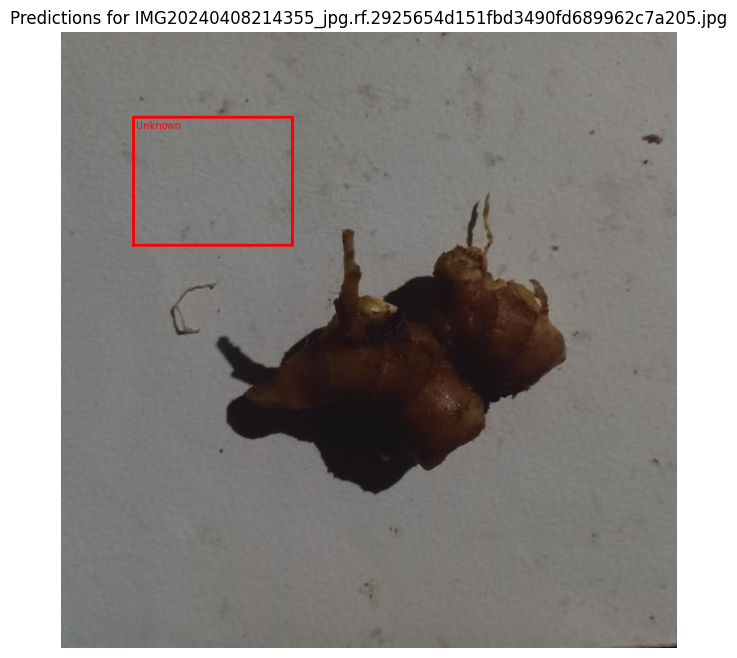

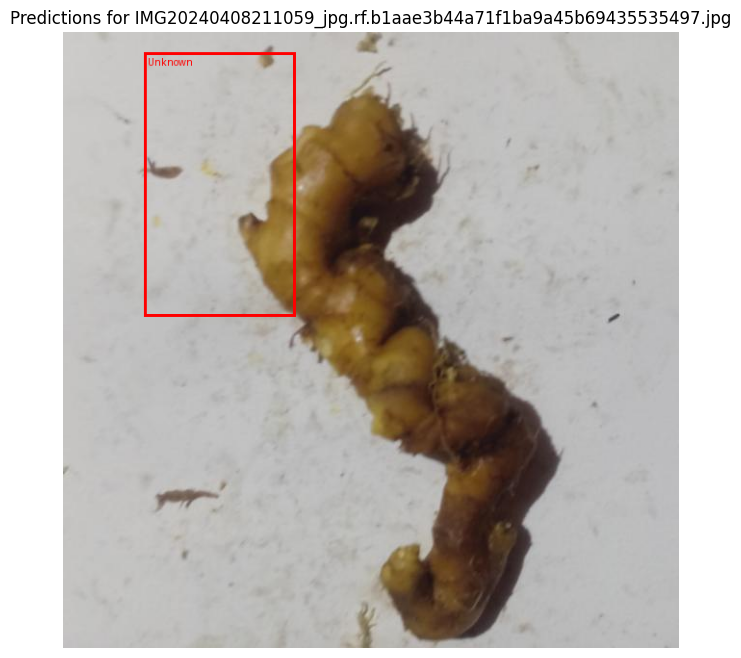

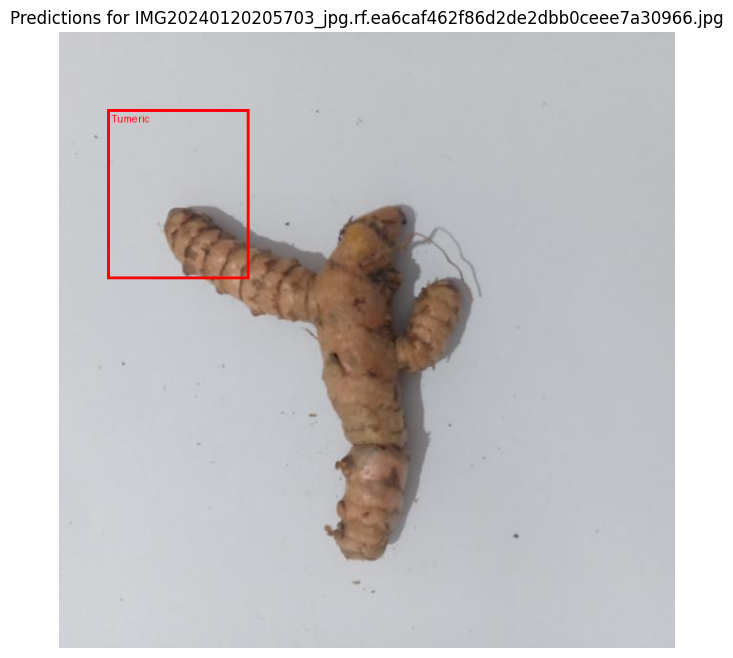

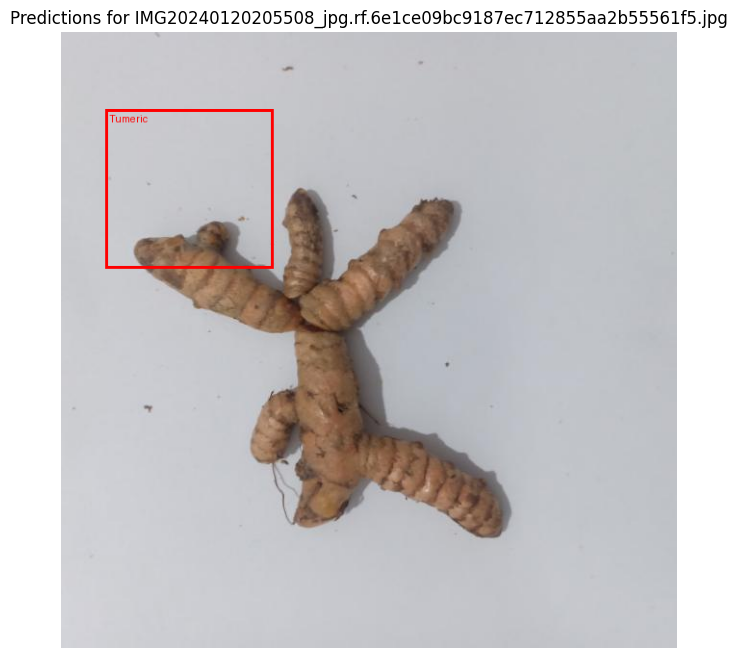

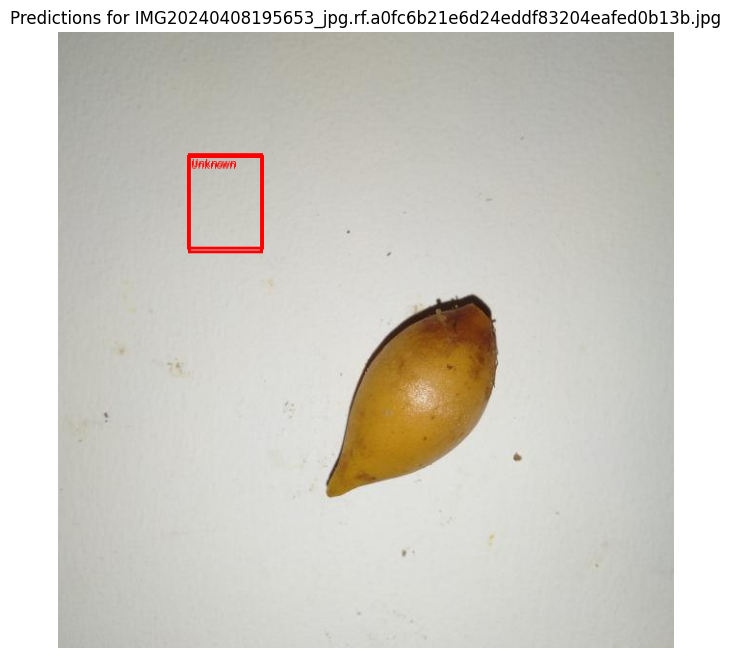

...

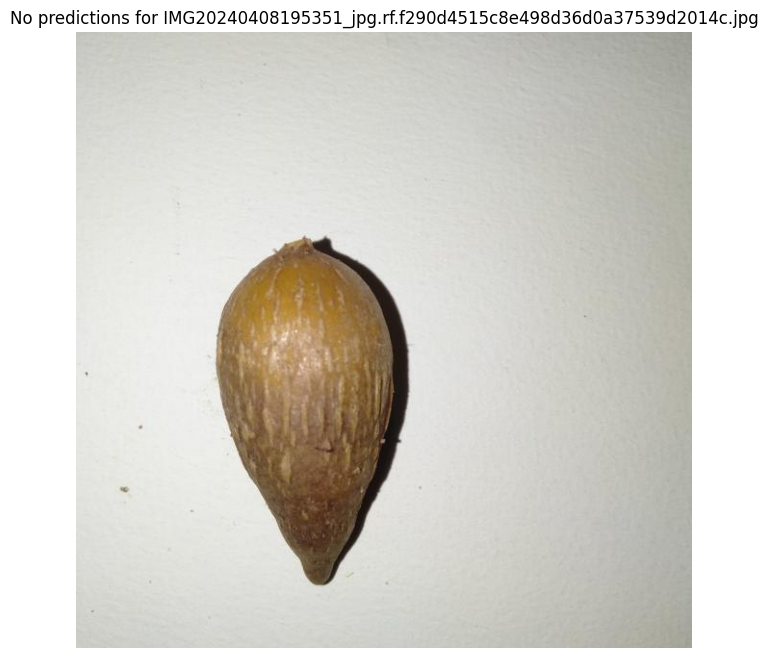

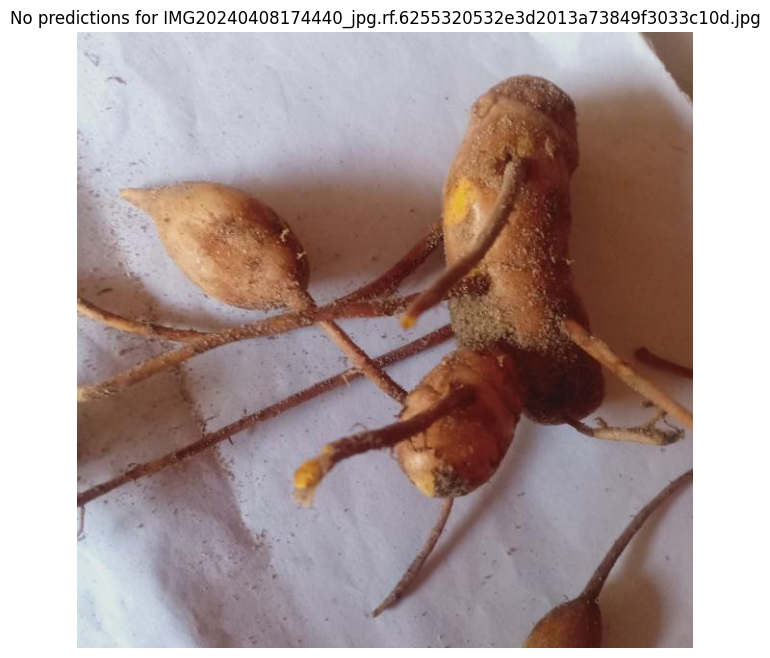

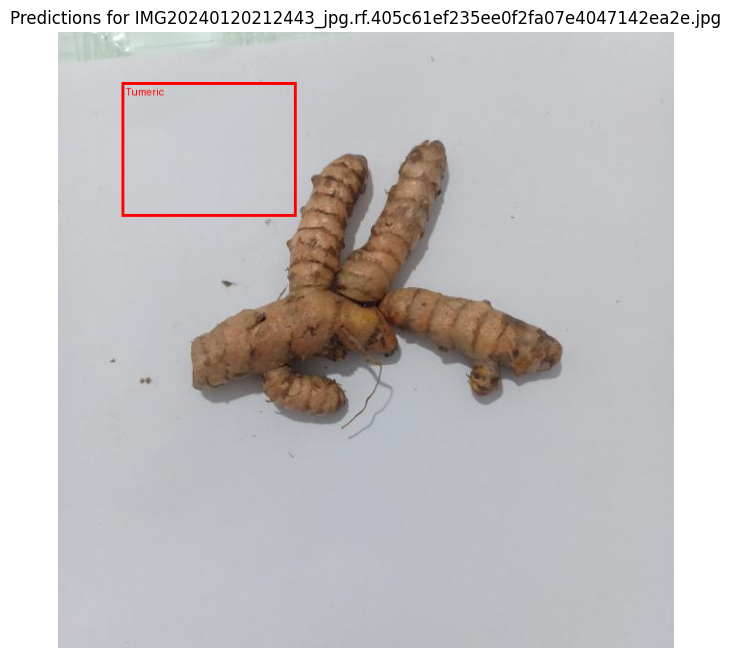

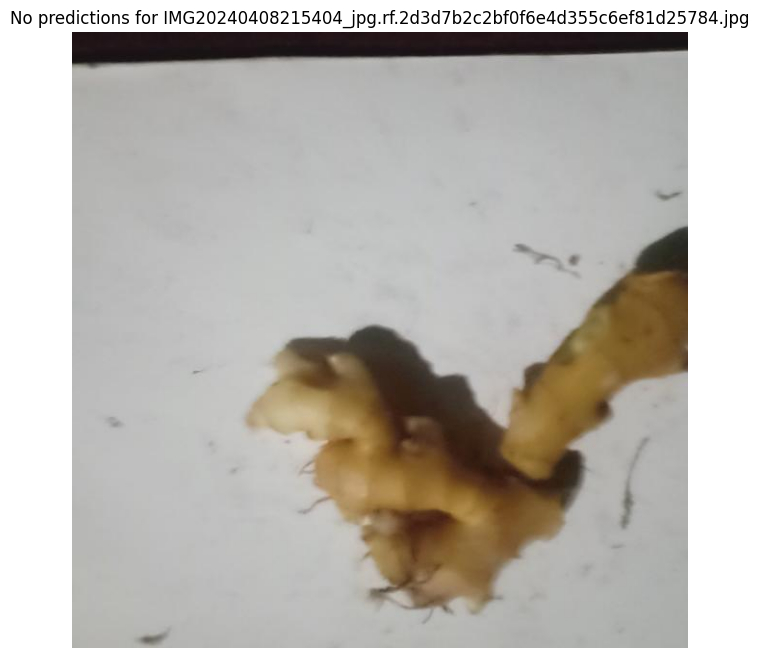

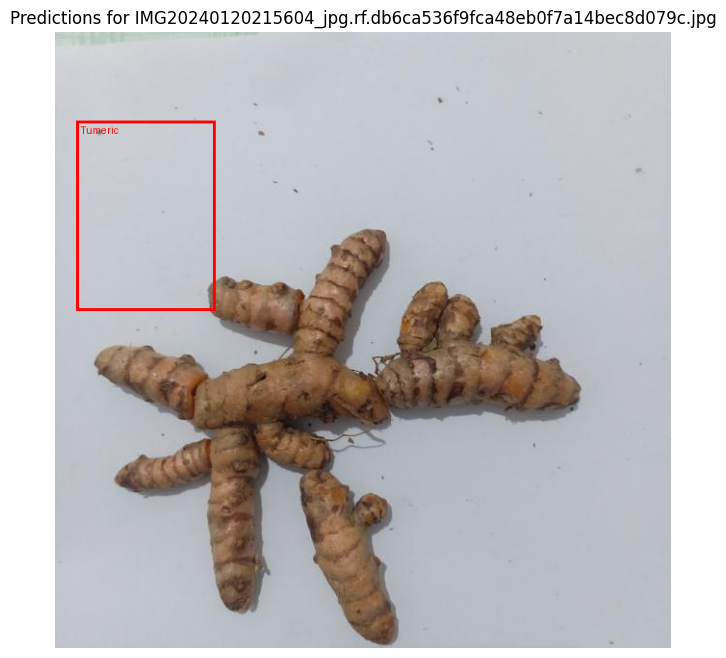

In [19]:
import os
import torch
import torchvision.transforms as T
from torchvision.utils import draw_bounding_boxes
from torchvision.models.detection import ssdlite320_mobilenet_v3_large, SSDLite320_MobileNet_V3_Large_Weights
from PIL import Image
import matplotlib.pyplot as plt

# Load the trained model (ensure it's in eval mode)
weights = SSDLite320_MobileNet_V3_Large_Weights.DEFAULT
num_classes = 4  # Change according to your model's classes
model = ssdlite320_mobilenet_v3_large(weights=weights)
model.head.classification_head.num_classes = num_classes  # Set to the number of classes
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
model.eval()

# Define the transformation for the input images
transform = T.Compose([
    T.Resize((300, 300)),
    T.ToTensor(),
])

# Define class names corresponding to the labels
class_names = {
    0: "Background",
    1: "Tumeric",
    2: "wildTumeric",
    3: "Ginger",
    # Add additional class mappings if needed
    # 4: "Class4",
    # 5: "Class5",
    # ...,
    # 16: "Class16",  # Example for label 16 if it exists
}

# Function to perform predictions on a directory of images
def predict_and_display_images(image_dir):
    # List all image files in the directory
    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

    for image_file in image_files:
        # Load and transform the image
        img_path = os.path.join(image_dir, image_file)
        image = Image.open(img_path).convert("RGB")
        img_tensor = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            predictions = model(img_tensor)

        # Draw the bounding boxes on the image
        boxes = predictions[0]['boxes'].cpu().numpy()
        labels = predictions[0]['labels'].cpu().numpy()
        scores = predictions[0]['scores'].cpu().numpy()

        # Filter out boxes with a score threshold
        threshold = 0.5
        boxes = boxes[scores > threshold]
        labels = labels[scores > threshold]

        # Map labels to class names with error handling
        mapped_labels = []
        for label in labels:
            # Use the label if it exists in the class_names, otherwise use 'Unknown'
            mapped_labels.append(class_names.get(int(label), "Unknown"))

        # Draw bounding boxes on the original image
        if boxes.size > 0:
            boxes = torch.tensor(boxes)  # Convert to tensor for drawing
            drawn_image = draw_bounding_boxes(T.ToTensor()(image), boxes, labels=mapped_labels, width=3, colors='red')
            plt.figure(figsize=(8, 8))
            plt.imshow(drawn_image.permute(1, 2, 0))  # Change from (C, H, W) to (H, W, C)
            plt.axis('off')
            plt.title(f'Predictions for {image_file}')
            plt.show()
        else:
            plt.figure(figsize=(8, 8))
            plt.imshow(image)
            plt.axis('off')
            plt.title(f'No predictions for {image_file}')
            plt.show()

# Specify the directory containing the images for prediction
image_directory = '/content/ayushvision_Tuber-2/test'  # Replace with your image directory
predict_and_display_images(image_directory)
